# Part 1: Data Preprocessing

In [1]:
# Import Library
import tensorflow as tf
from tensorflow.keras.preprocessing.image import ImageDataGenerator
import os
import zipfile

In [2]:
# Mount Google Drive
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# Extract the dataset
zip_path = '/content/drive/My Drive/dataset.zip'  # Update with the path to your dataset zip file
with zipfile.ZipFile(zip_path, 'r') as zip_ref:
    zip_ref.extractall('/content/data')

In [4]:
# Set directories
base_dir = '/content/data'
train_dir = os.path.join(base_dir, 'train')
test_dir = os.path.join(base_dir, 'test')

## Data Augmentation

In [5]:

# Data augmentation and normalization
train_datagen = ImageDataGenerator(
    rescale=1./255,
    rotation_range=45,  # Increased rotation range
    width_shift_range=0.3,  # Increased width shift range
    height_shift_range=0.3,  # Increased height shift range
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest',
    validation_split=0.2
)

test_datagen = ImageDataGenerator(rescale=1./255)

# Data generators
train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='categorical',
    subset='training'
)

validation_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='categorical',
    subset='validation'
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='categorical'
)

Found 1875 images belonging to 10 classes.
Found 464 images belonging to 10 classes.
Found 50 images belonging to 10 classes.


# Part 2: Model Building

In [ ]:
# Create CNN model
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, Dropout

model = Sequential([
    Conv2D(32, (3, 3), activation='relu', input_shape=(150, 150, 3)),
    MaxPooling2D((2, 2)),
    Conv2D(64, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Conv2D(128, (3, 3), activation='relu'),
    MaxPooling2D((2, 2)),
    Flatten(),
    Dense(512, activation='relu'),
    Dropout(0.5),  # Added dropout layer
    Dense(10, activation='softmax')
])

# Compile the model
model.compile(optimizer='adam',
              loss='categorical_crossentropy',
              metrics=['accuracy'])

model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 148, 148, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2  (None, 74, 74, 32)        0         
 D)                                                              
                                                                 
 conv2d_1 (Conv2D)           (None, 72, 72, 64)        18496     
                                                                 
 max_pooling2d_1 (MaxPoolin  (None, 36, 36, 64)        0         
 g2D)                                                            
                                                                 
 conv2d_2 (Conv2D)           (None, 34, 34, 128)       73856     
                                                                 
 max_pooling2d_2 (MaxPoolin  (None, 17, 17, 128)       0

# Part 3: Model Training

In [ ]:
# Training Model
history = model.fit(
    train_generator,
    steps_per_epoch=train_generator.samples // train_generator.batch_size,
    validation_data=validation_generator,
    validation_steps=validation_generator.samples // validation_generator.batch_size,
    epochs=200
)

Epoch 1/200
58/58 [==============================] - 27s 333ms/step - loss: 2.2932 - accuracy: 0.1161 - val_loss: 2.1567 - val_accuracy: 0.1607
Epoch 2/200
58/58 [==============================] - 18s 311ms/step - loss: 2.0431 - accuracy: 0.2062 - val_loss: 1.8195 - val_accuracy: 0.2835
Epoch 3/200
58/58 [==============================] - 17s 294ms/step - loss: 1.9138 - accuracy: 0.2594 - val_loss: 1.7583 - val_accuracy: 0.3080
Epoch 4/200
58/58 [==============================] - 18s 314ms/step - loss: 1.8786 - accuracy: 0.2626 - val_loss: 1.8123 - val_accuracy: 0.2991
Epoch 5/200
58/58 [==============================] - 18s 316ms/step - loss: 1.8044 - accuracy: 0.3039 - val_loss: 1.6579 - val_accuracy: 0.3839
Epoch 6/200
58/58 [==============================] - 16s 271ms/step - loss: 1.7107 - accuracy: 0.3397 - val_loss: 1.7938 - val_accuracy: 0.2790
Epoch 7/200
58/58 [==============================] - 16s 273ms/step - loss: 1.7306 - accuracy: 0.3348 - val_loss: 1.7430 - val_accuracy:

# Part 4: Model Evaluation and Prediction"

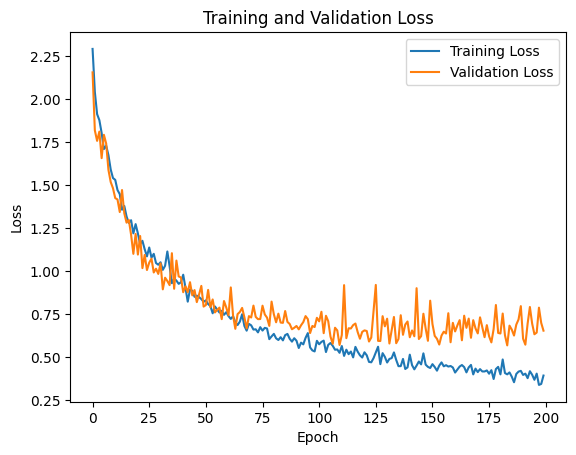

In [ ]:
import matplotlib.pyplot as plt

# Plot training and validation loss
plt.plot(history.history['loss'], label='Training Loss')
plt.plot(history.history['val_loss'], label='Validation Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.title('Training and Validation Loss')
plt.legend()
plt.show()

In [ ]:
# Evaluate the model
test_loss, test_acc = model.evaluate(test_generator)
print(f'Test accuracy: {test_acc:.2f}')

2/2 [==============================] - 1s 434ms/step - loss: 0.4809 - accuracy: 0.8200
Test accuracy: 0.82


In [ ]:
# Save the model in .h5 format
model.save('/content/drive/My Drive/model.h5')

/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py:3103: UserWarning: You are saving your model as an HDF5 file via `model.save()`. This file format is considered legacy. We recommend using instead the native Keras format, e.g. `model.save('my_model.keras')`.
  saving_api.save_model(


In [ ]:
# Save the model in SavedModel format
model.save('/content/drive/My Drive/saved_model')

In [6]:
# Load the model from .h5 file
loaded_model_h5 = tf.keras.models.load_model('/content/drive/My Drive/model.h5')

# Load the model from SavedModel format
loaded_model_saved = tf.keras.models.load_model('/content/drive/My Drive/saved_model')

1/1 [==============================] - 2s 2s/step


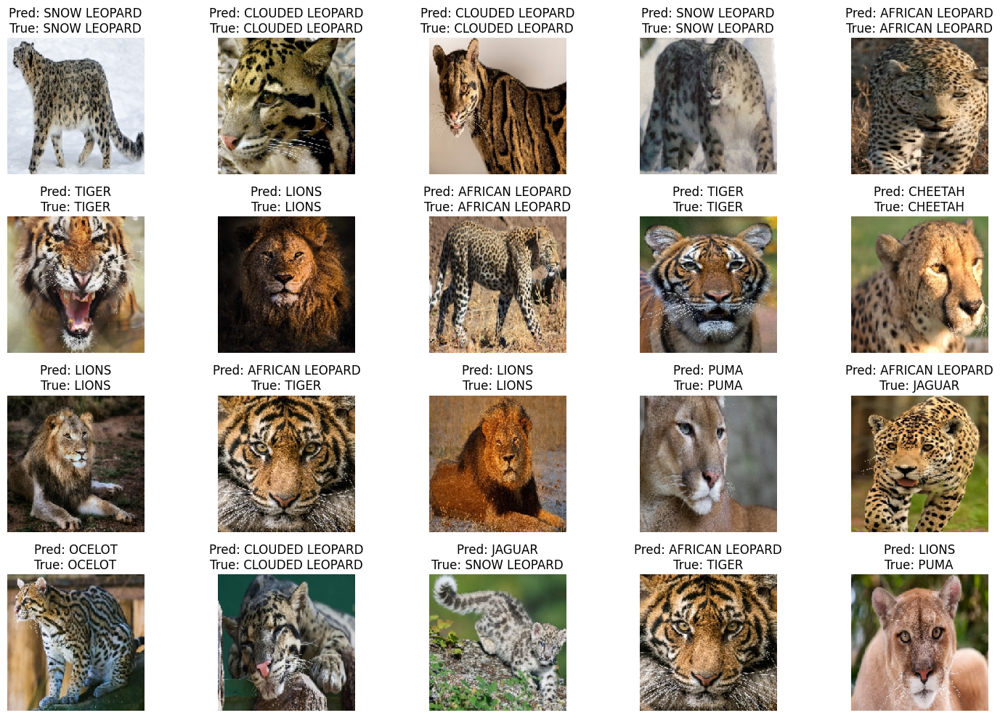

Jumlah prediksi yang benar dari 20 gambar: 15
Jumlah prediksi yang salah dari 20 gambar: 5


In [8]:
import numpy as np
import matplotlib.pyplot as plt

def plot_random_samples(generator, num_samples=20):
    # Get class labels
    class_labels = list(generator.class_indices.keys())

    # Initialize lists to store images and labels
    images_list = []
    labels_list = []

    # Collect enough images and labels
    while len(images_list) < num_samples:
        images, labels = next(generator)
        for i in range(images.shape[0]):
            images_list.append(images[i])
            labels_list.append(labels[i])
            if len(images_list) >= num_samples:
                break

    # Convert lists to numpy arrays
    images = np.array(images_list)
    labels = np.array(labels_list)

    # Make predictions
    predictions = loaded_model_h5.predict(images)
    predicted_labels = np.argmax(predictions, axis=1)
    true_labels = np.argmax(labels, axis=1)

    # Calculate correct predictions
    correct_predictions = np.sum(predicted_labels == true_labels)
    incorrect_predictions = num_samples - correct_predictions

    # Plot images with predictions and true labels
    plt.figure(figsize=(15, 10))
    for i in range(num_samples):
        plt.subplot(4, 5, i+1)
        plt.imshow(images[i])
        plt.title(f'Pred: {class_labels[predicted_labels[i]]}\nTrue: {class_labels[true_labels[i]]}')
        plt.axis('off')
    plt.tight_layout()
    plt.show()

    print(f'Jumlah prediksi yang benar dari 20 gambar: {correct_predictions}')
    print(f'Jumlah prediksi yang salah dari 20 gambar: {incorrect_predictions}')

# Usage example:
plot_random_samples(test_generator, num_samples=20)


1/1 [==============================] - 0s 243ms/step


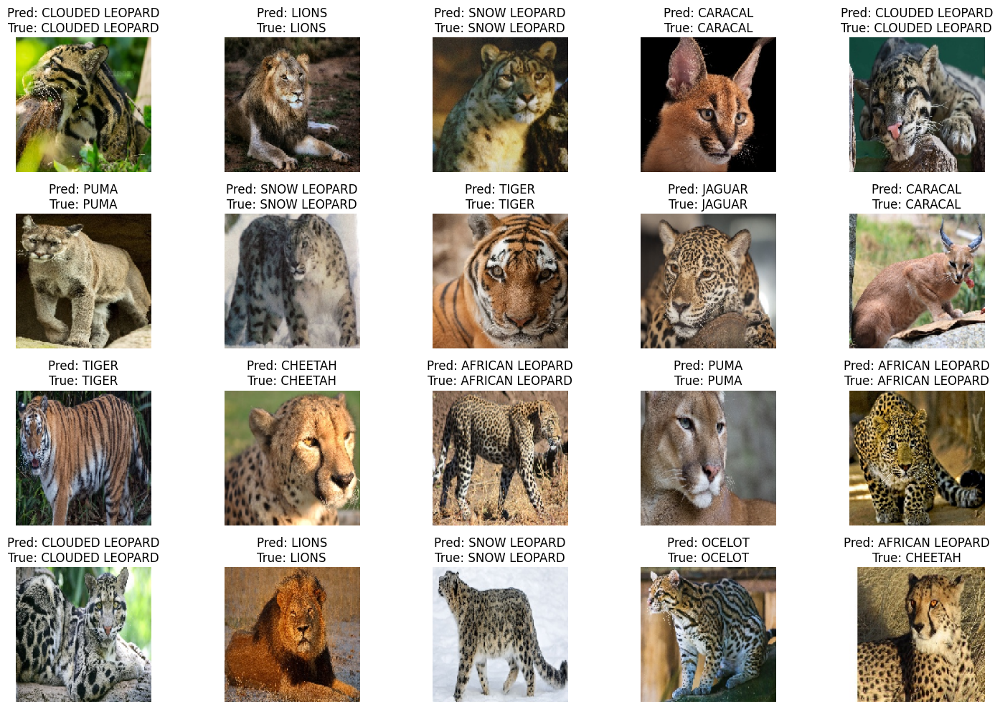

Jumlah prediksi yang benar dari 20 gambar: 19
Jumlah prediksi yang salah dari 20 gambar: 1


In [9]:
plot_random_samples(test_generator, num_samples=20)

1/1 [==============================] - 0s 248ms/step


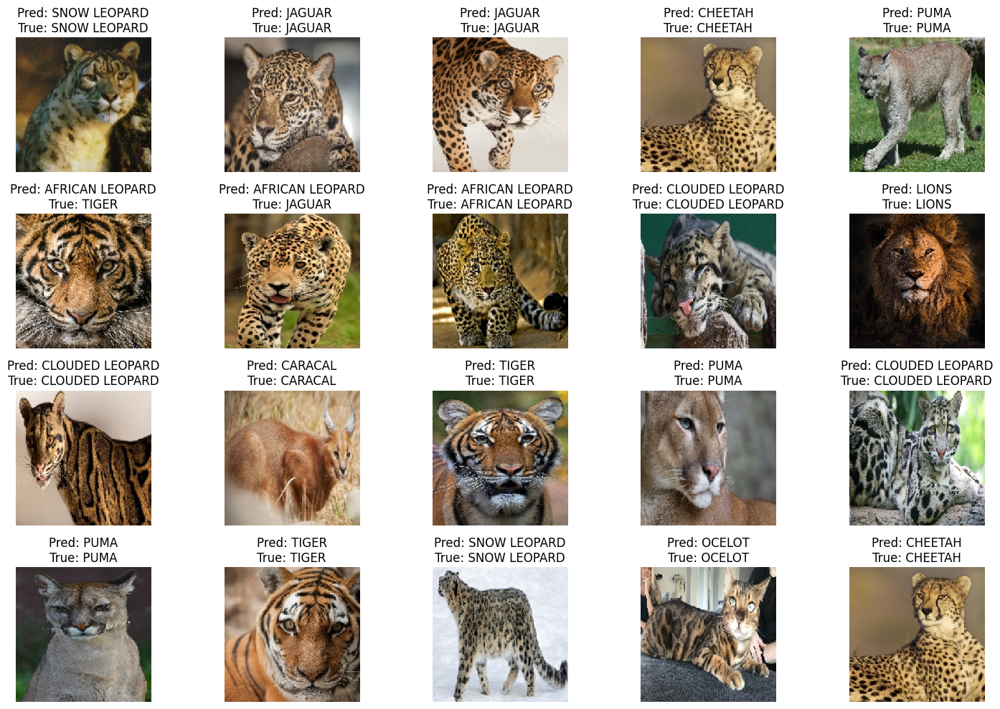

Jumlah prediksi yang benar dari 20 gambar: 18
Jumlah prediksi yang salah dari 20 gambar: 2


In [10]:
plot_random_samples(test_generator, num_samples=20)

1/1 [==============================] - 0s 256ms/step


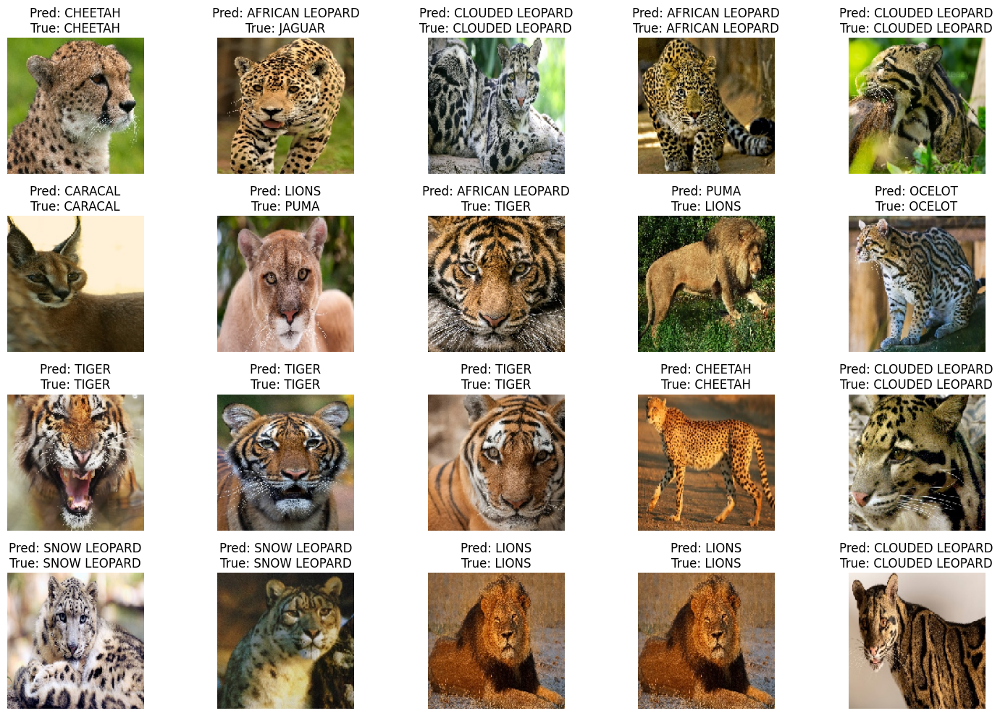

Jumlah prediksi yang benar dari 20 gambar: 16
Jumlah prediksi yang salah dari 20 gambar: 4


In [11]:
plot_random_samples(test_generator, num_samples=20)

1/1 [==============================] - 0s 235ms/step


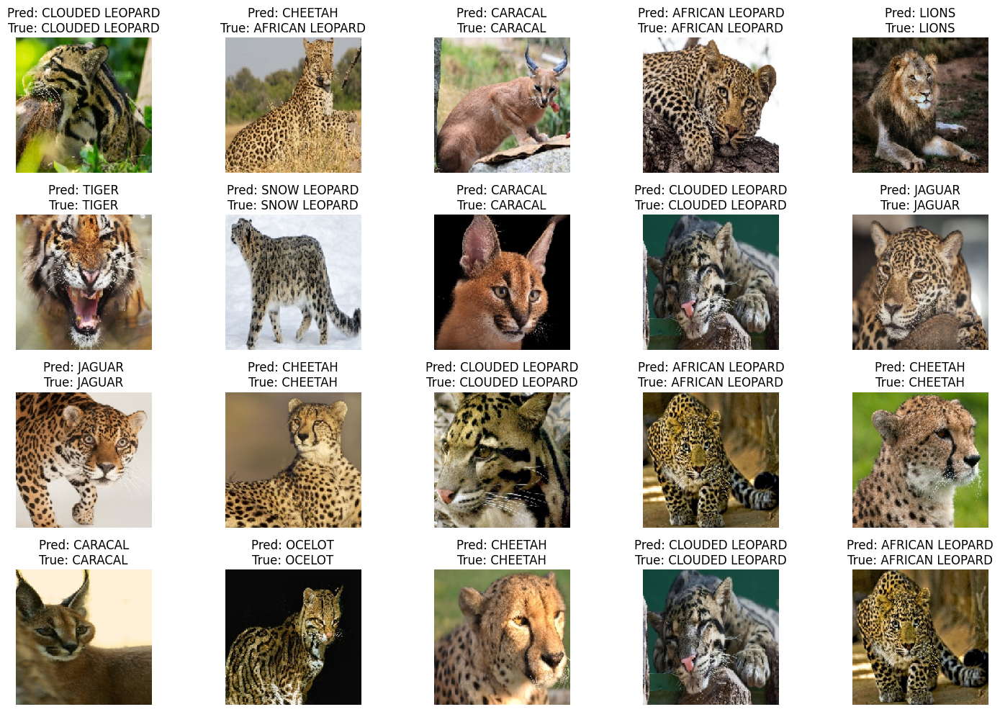

Jumlah prediksi yang benar dari 20 gambar: 19
Jumlah prediksi yang salah dari 20 gambar: 1


In [12]:
plot_random_samples(test_generator, num_samples=20)

1/1 [==============================] - 0s 27ms/step


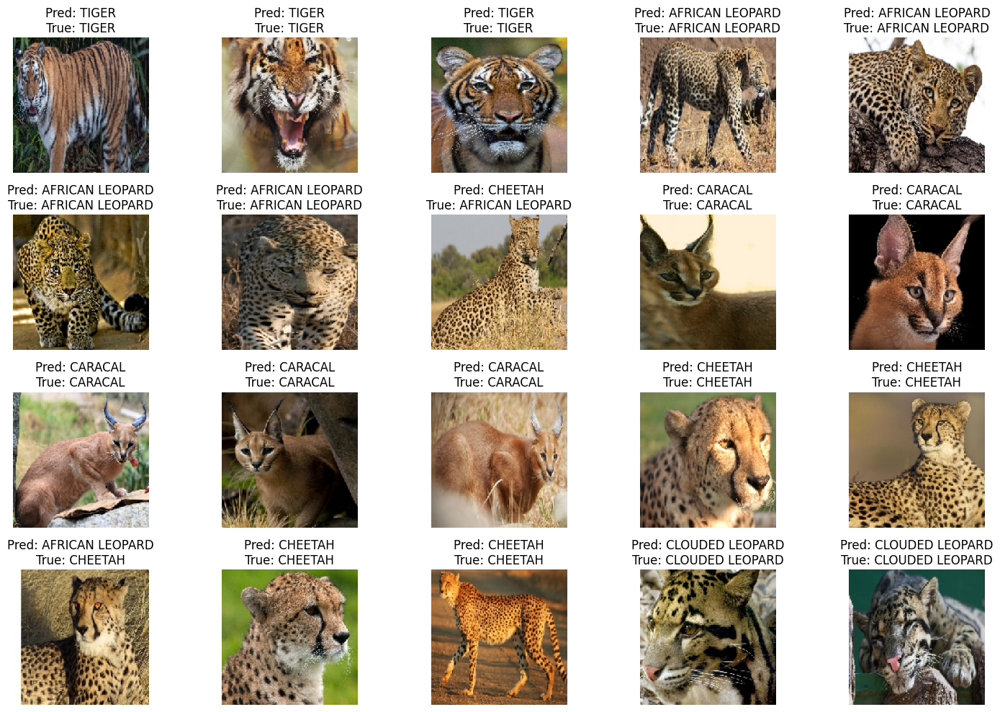

Jumlah prediksi yang benar dari 20 gambar: 18
Jumlah prediksi yang salah dari 20 gambar: 2


In [ ]:
plot_random_samples(test_generator, num_samples=20)

# Part 5: Testing to unknown data

In [13]:
# Extract the data uji.zip
data_uji_zip_path = '/content/drive/My Drive/data uji.zip'  # Update with the path to your data uji zip file
with zipfile.ZipFile(data_uji_zip_path, 'r') as zip_ref:
    zip_ref.extractall('/content/data_uji')

In [14]:
data_uji_dir = '/content/data_uji/valid'  # Directory containing data uji

In [15]:
# Data generator for data uji
data_uji_generator = test_datagen.flow_from_directory(
    data_uji_dir,
    target_size=(150, 150),
    batch_size=32,
    class_mode='categorical'
)

Found 50 images belonging to 10 classes.


Saving lion5.jpg to lion5.jpg
1/1 [==============================] - 0s 30ms/step


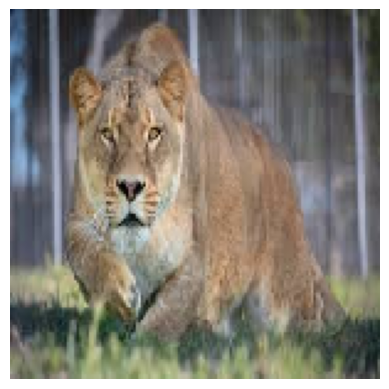

Predicted class: LIONS


In [56]:
# Import library
from keras.preprocessing import image

# Define class labels
class_labels = sorted(train_generator.class_indices.keys())

# Upload image
uploaded = files.upload()

# Load and preprocess the image
for filename in uploaded.keys():
    img_path = '/content/' + filename
    test_image = image.load_img(img_path, target_size=(150, 150))
    test_image = image.img_to_array(test_image)
    test_image = np.expand_dims(test_image, axis=0)
    test_image /= 255.0  # Rescale to [0, 1]

    # Predict the class
    prediction = loaded_model_h5.predict(test_image)
    predicted_class = np.argmax(prediction, axis=1)[0]
    class_name = class_labels[predicted_class]

    # Display the image and prediction
    plt.imshow(image.load_img(img_path, target_size=(150, 150)))
    plt.axis('off')
    plt.show()
    print(f"Predicted class: {class_name}")


1/1 [==============================] - 0s 246ms/step


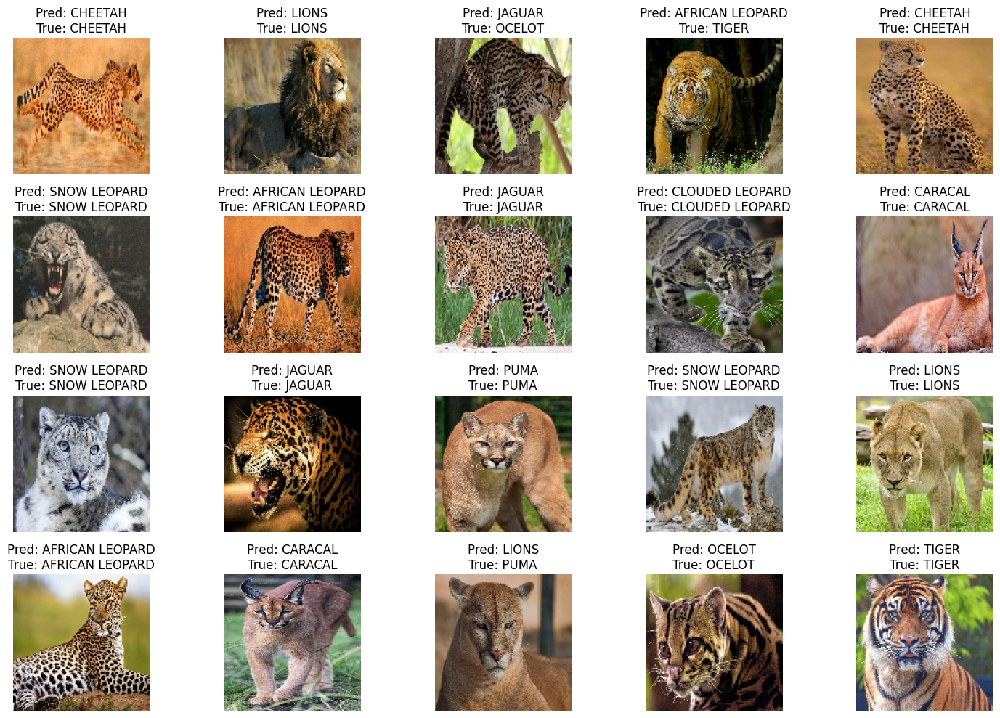

Jumlah prediksi yang benar dari 20 gambar: 17
Jumlah prediksi yang salah dari 20 gambar: 3


In [16]:
import numpy as np

def plot_random_samples(generator, model, num_samples=20):
    # Get class labels
    class_labels = list(generator.class_indices.keys())

    # Initialize lists to store images and labels
    images_list = []
    labels_list = []

    # Collect enough images and labels
    while len(images_list) < num_samples:
        images, labels = next(generator)
        for i in range(images.shape[0]):
            images_list.append(images[i])
            labels_list.append(labels[i])
            if len(images_list) >= num_samples:
                break

    # Convert lists to numpy arrays
    images = np.array(images_list)
    labels = np.array(labels_list)

    # Make predictions
    predictions = model.predict(images)
    predicted_labels = np.argmax(predictions, axis=1)
    true_labels = np.argmax(labels, axis=1)

    # Calculate correct predictions
    correct_predictions = np.sum(predicted_labels == true_labels)
    incorrect_predictions = num_samples - correct_predictions

    # Plot images with predictions and true labels
    plt.figure(figsize=(15, 10))
    for i in range(num_samples):
        plt.subplot(4, 5, i+1)
        plt.imshow(images[i])
        plt.title(f'Pred: {class_labels[predicted_labels[i]]}\nTrue: {class_labels[true_labels[i]]}')
        plt.axis('off')
    plt.tight_layout()
    plt.show()

    print(f'Jumlah prediksi yang benar dari 20 gambar: {correct_predictions}')
    print(f'Jumlah prediksi yang salah dari 20 gambar: {incorrect_predictions}')

# Usage example with the loaded model
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

1/1 [==============================] - 0s 235ms/step


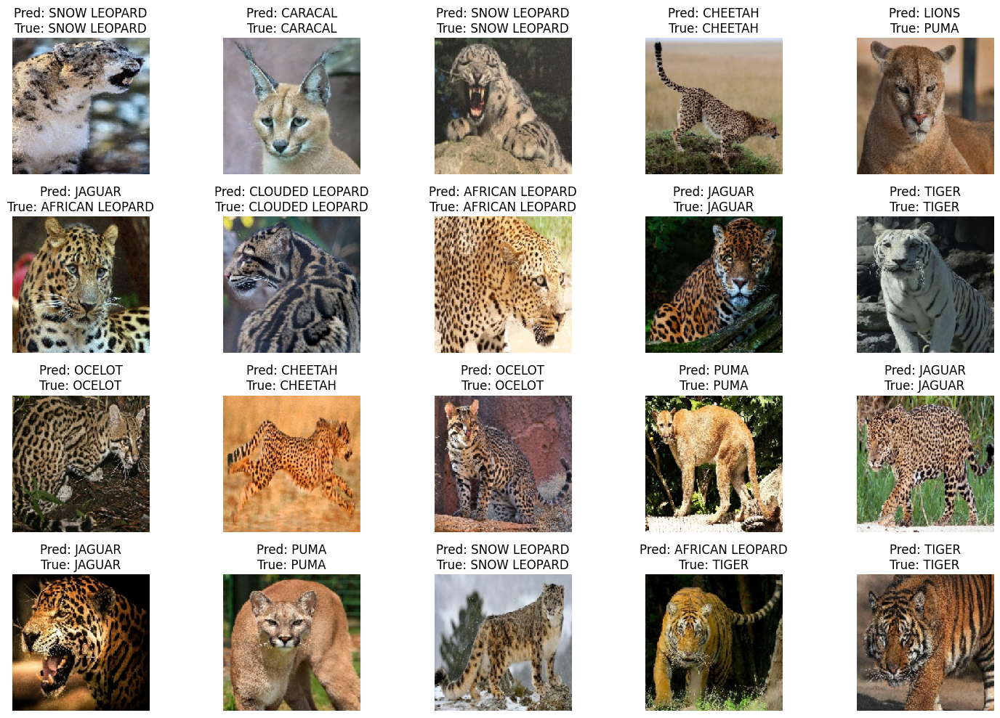

Jumlah prediksi yang benar dari 20 gambar: 17
Jumlah prediksi yang salah dari 20 gambar: 3


In [18]:
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

1/1 [==============================] - 0s 392ms/step


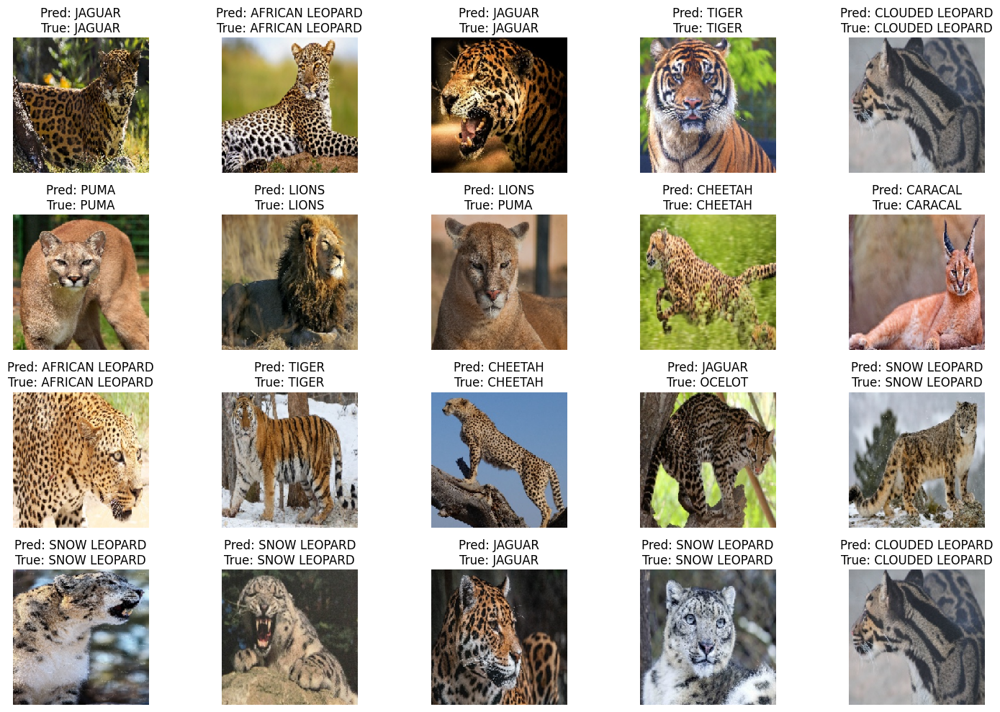

Jumlah prediksi yang benar dari 20 gambar: 18
Jumlah prediksi yang salah dari 20 gambar: 2


In [19]:
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

1/1 [==============================] - 0s 417ms/step


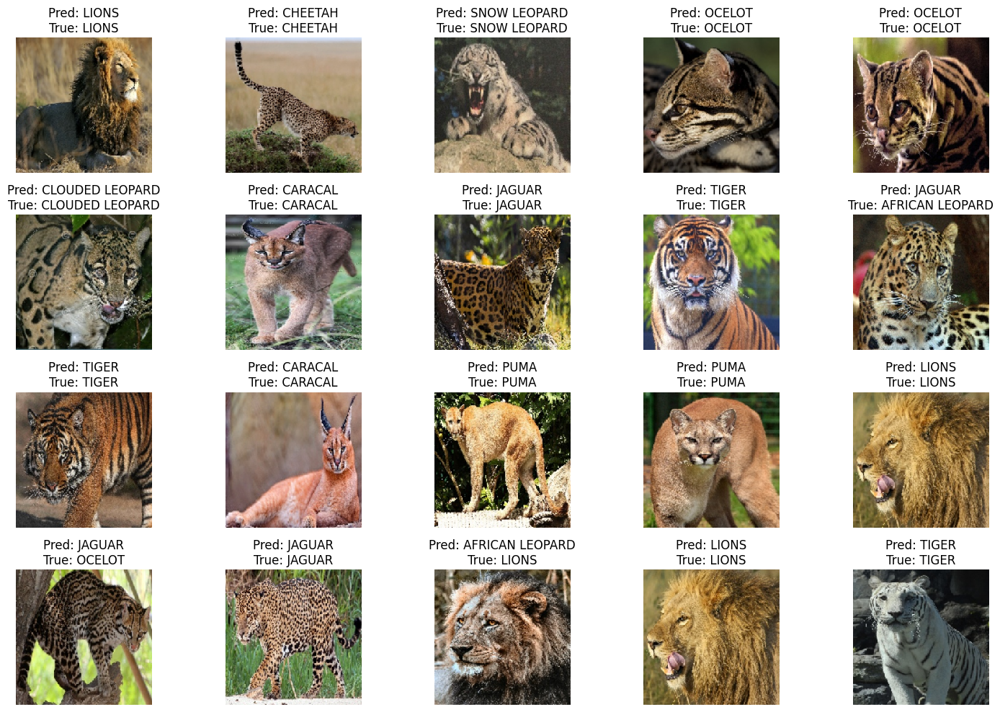

Jumlah prediksi yang benar dari 20 gambar: 17
Jumlah prediksi yang salah dari 20 gambar: 3


In [20]:
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

1/1 [==============================] - 0s 234ms/step


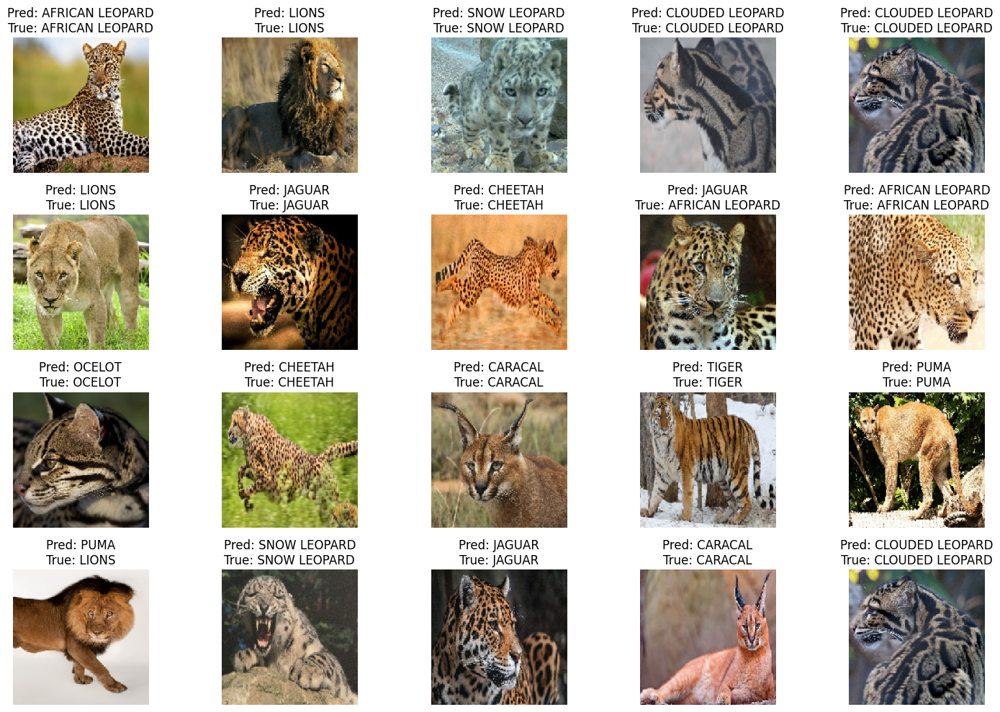

Jumlah prediksi yang benar dari 20 gambar: 18
Jumlah prediksi yang salah dari 20 gambar: 2


In [21]:
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

1/1 [==============================] - 0s 233ms/step


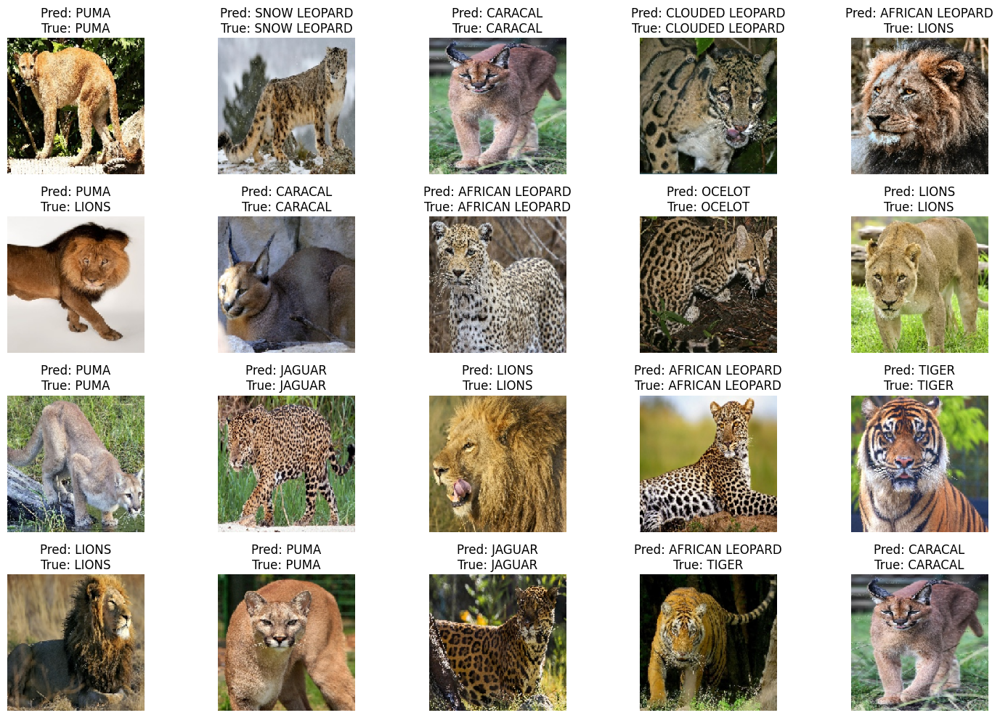

Jumlah prediksi yang benar dari 20 gambar: 17
Jumlah prediksi yang salah dari 20 gambar: 3


In [22]:
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

1/1 [==============================] - 0s 234ms/step


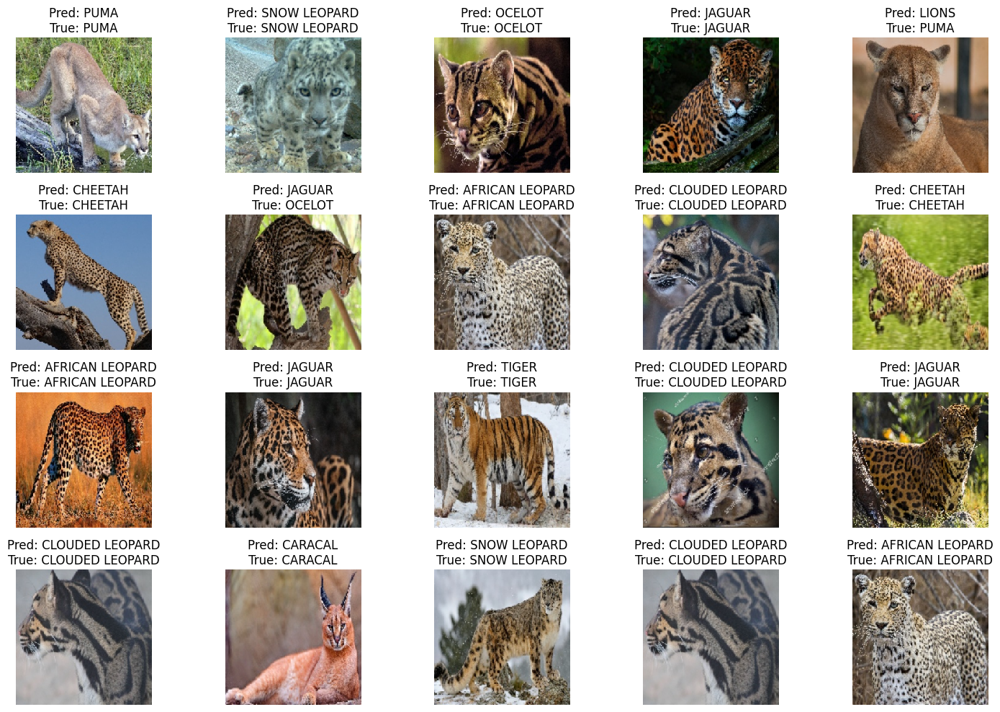

Jumlah prediksi yang benar dari 20 gambar: 18
Jumlah prediksi yang salah dari 20 gambar: 2


In [23]:
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

1/1 [==============================] - 0s 229ms/step


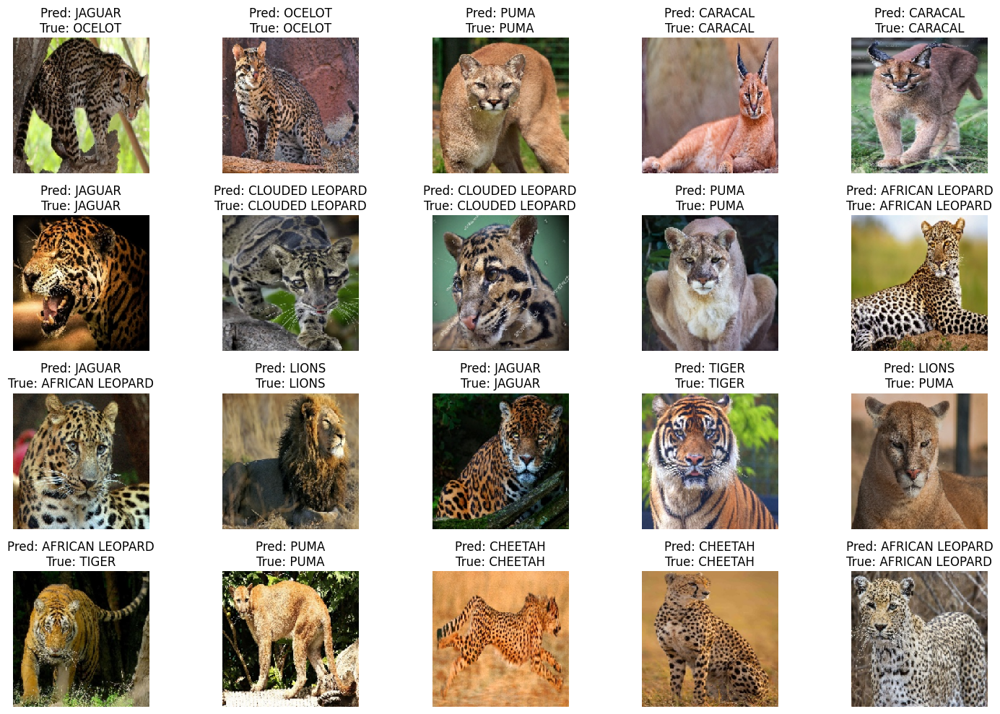

Jumlah prediksi yang benar dari 20 gambar: 16
Jumlah prediksi yang salah dari 20 gambar: 4


In [24]:
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

1/1 [==============================] - 0s 248ms/step


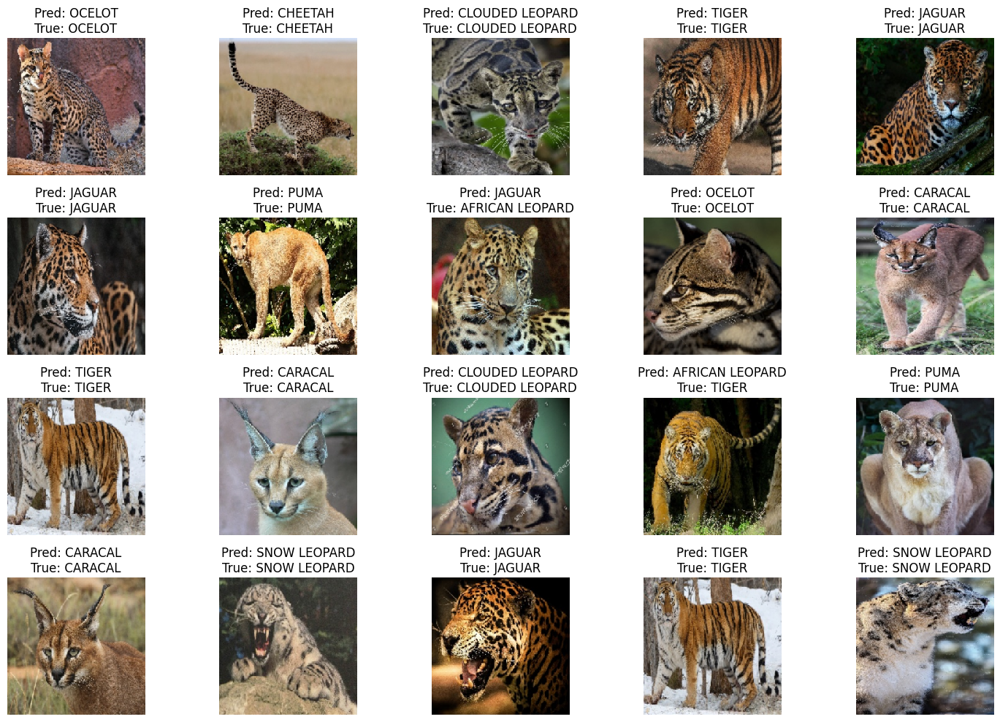

Jumlah prediksi yang benar dari 20 gambar: 18
Jumlah prediksi yang salah dari 20 gambar: 2


In [25]:
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

1/1 [==============================] - 0s 473ms/step


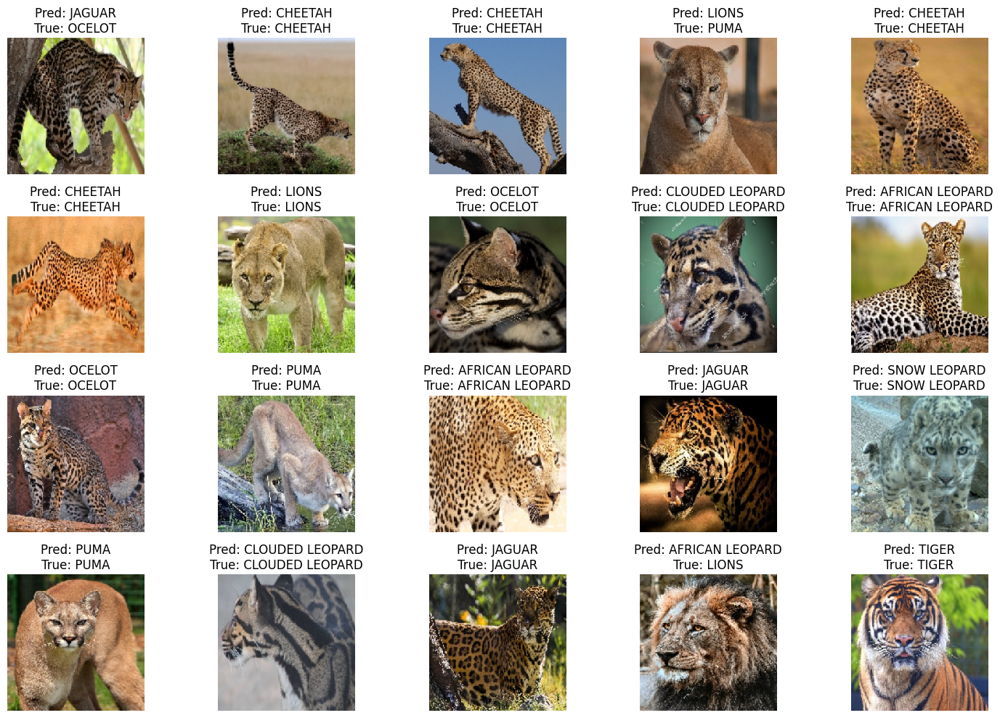

Jumlah prediksi yang benar dari 20 gambar: 17
Jumlah prediksi yang salah dari 20 gambar: 3


In [26]:
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

1/1 [==============================] - 0s 227ms/step


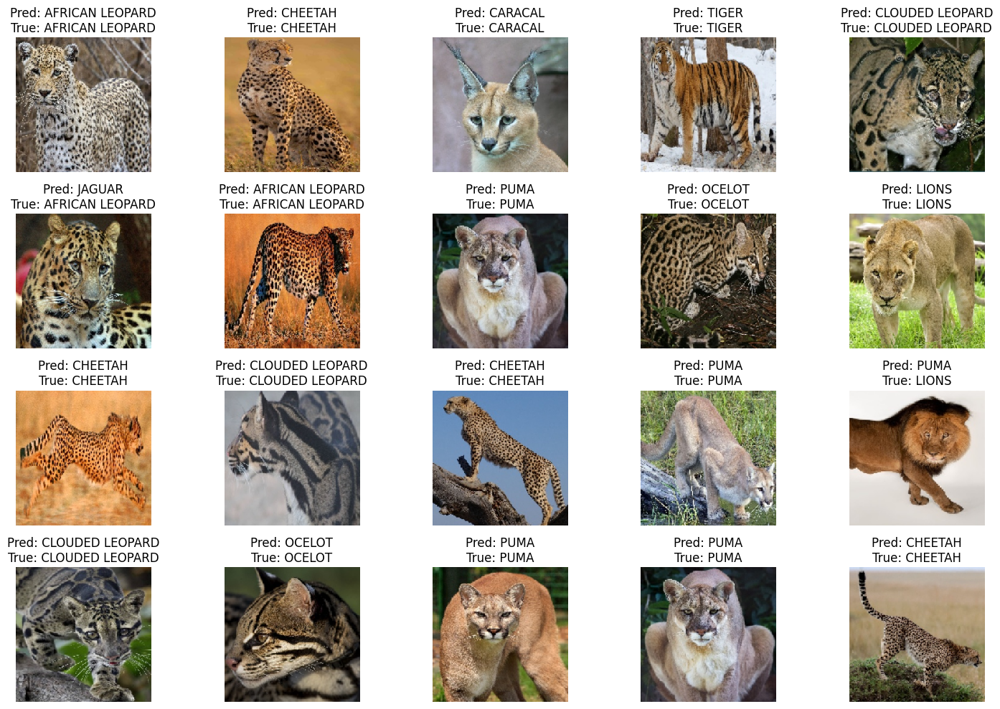

Jumlah prediksi yang benar dari 20 gambar: 18
Jumlah prediksi yang salah dari 20 gambar: 2


In [27]:
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

1/1 [==============================] - 0s 230ms/step


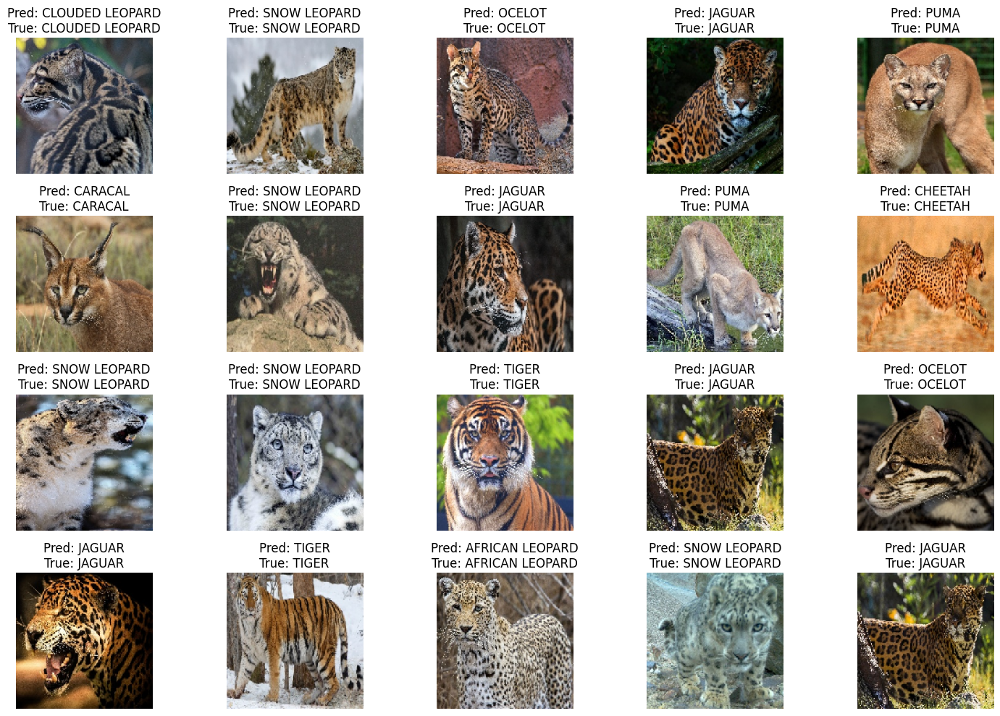

Jumlah prediksi yang benar dari 20 gambar: 20
Jumlah prediksi yang salah dari 20 gambar: 0


In [28]:
plot_random_samples(data_uji_generator, loaded_model_h5, num_samples=20)

In [30]:
import numpy as np
from keras.preprocessing import image
from google.colab import files
from IPython.display import Image

In [33]:
# Upload image
uploaded = files.upload()


for filename in uploaded.keys():
    # Load and preprocess the image
    test_image = image.load_img(filename, target_size=(128, 128))
    test_image = image.img_to_array(test_image)
    test_image = np.expand_dims(test_image, axis=0)

    # Predict the class
    result = loaded_model_h5.predict(test_image)
    class_indices = data_uji_generator.class_indices
    class_indices = {v: k for k, v in class_indices.items()}
    prediction = class_indices[np.argmax(result)]

    # Display the image and prediction
    display(Image(filename=filename))
    print(f"Predicted class: {prediction}")

Saving 1.jpg to 1 (2).jpg


InvalidArgumentError: Graph execution error:

Detected at node sequential/dense/Relu defined at (most recent call last):
  File "/usr/lib/python3.10/runpy.py", line 196, in _run_module_as_main

  File "/usr/lib/python3.10/runpy.py", line 86, in _run_code

  File "/usr/local/lib/python3.10/dist-packages/colab_kernel_launcher.py", line 37, in <module>

  File "/usr/local/lib/python3.10/dist-packages/traitlets/config/application.py", line 992, in launch_instance

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelapp.py", line 619, in start

  File "/usr/local/lib/python3.10/dist-packages/tornado/platform/asyncio.py", line 195, in start

  File "/usr/lib/python3.10/asyncio/base_events.py", line 603, in run_forever

  File "/usr/lib/python3.10/asyncio/base_events.py", line 1909, in _run_once

  File "/usr/lib/python3.10/asyncio/events.py", line 80, in _run

  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 685, in <lambda>

  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 738, in _run_callback

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 825, in inner

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 786, in run

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 361, in process_one

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 261, in dispatch_shell

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 539, in execute_request

  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py", line 302, in do_execute

  File "/usr/local/lib/python3.10/dist-packages/ipykernel/zmqshell.py", line 539, in run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 2975, in run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3030, in _run_cell

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/async_helpers.py", line 78, in _pseudo_sync_runner

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3257, in run_cell_async

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3473, in run_ast_nodes

  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code

  File "<ipython-input-32-ba84754dd8f4>", line 12, in <cell line: 5>

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 65, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2655, in predict

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2440, in predict_function

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2425, in step_function

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2413, in run_step

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 2381, in predict_step

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 65, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/training.py", line 590, in __call__

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 65, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/base_layer.py", line 1149, in __call__

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 96, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/sequential.py", line 398, in call

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/functional.py", line 515, in call

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/functional.py", line 672, in _run_internal_graph

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 65, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/engine/base_layer.py", line 1149, in __call__

  File "/usr/local/lib/python3.10/dist-packages/keras/src/utils/traceback_utils.py", line 96, in error_handler

  File "/usr/local/lib/python3.10/dist-packages/keras/src/layers/core/dense.py", line 255, in call

  File "/usr/local/lib/python3.10/dist-packages/keras/src/activations.py", line 306, in relu

  File "/usr/local/lib/python3.10/dist-packages/keras/src/backend.py", line 5395, in relu

Matrix size-incompatible: In[0]: [1,4608], In[1]: [6272,512]
	 [[{{node sequential/dense/Relu}}]] [Op:__inference_predict_function_3024]

# Part 6: Api

In [ ]:
!pip install Flask
!pip install pyngrok

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
from flask import Flask, request, jsonify
import tensorflow as tf
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing import image
import numpy as np
import os
from google.colab import drive
from pyngrok import ngrok

# Mount Google Drive
drive.mount('/content/drive')

# Load the model
model_path = '/content/drive/My Drive/model.h5'
loaded_model = load_model(model_path)

# Function to preprocess image
def preprocess_image(image_path, target_size=(150, 150)):
    img = image.load_img(image_path, target_size=target_size)
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    img_array /= 255.0  # Rescale to [0, 1]
    return img_array

# Get class labels
base_dir = '/content/data'
train_dir = os.path.join(base_dir, 'train')
class_labels = sorted(os.listdir(train_dir))

app = Flask(__name__)

@app.route('/predict', methods=['POST'])
def predict():
    print(request.files)  # Debug: Print the files part of the request
    if 'file' not in request.files:
        return jsonify({'error': 'No file part in the request'}), 400

    file = request.files['file']
    print("Received file:", file.filename)  # Debug: Print the received file's filename
    if file.filename == '':
        return jsonify({'error': 'No selected file'}), 400

    # Save the uploaded file to a location
    upload_path = '/tmp/uploaded_image.jpg'
    file.save(upload_path)

    # Preprocess the image
    img_array = preprocess_image(upload_path)

    # Make prediction
    prediction = loaded_model.predict(img_array)
    predicted_class = np.argmax(prediction, axis=1)[0]
    class_name = class_labels[predicted_class]

    # Return JSON response
    return jsonify({
        'class': class_name
    })

# Set ngrok authtoken and start ngrok
authtoken = "2h3Oz432OGSdTgS1P92qoJ7oc0C_CXpAc1EPr4pqsfmR8Mce"  # Replace with your actual authtoken
ngrok.set_auth_token(authtoken)

# Open an HTTP tunnel on the default port 5000
public_url = ngrok.connect(5000, bind_tls=True)
print(f"Public URL: {public_url}")

# Run the app
app.run()


Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
Public URL: NgrokTunnel: "https://9d37-34-32-173-41.ngrok-free.app" -> "http://localhost:5000"
 * Serving Flask app '__main__'
 * Debug mode: off


INFO:werkzeug:WARNING: This is a development server. Do not use it in a production deployment. Use a production WSGI server instead.
 * Running on http://127.0.0.1:5000
INFO:werkzeug:Press CTRL+C to quit


ImmutableMultiDict([('file', <FileStorage: '1.jpg' ('image/jpeg')>)])
Received file: 1.jpg
1/1 [==============================] - 0s 77ms/step


INFO:werkzeug:127.0.0.1 - - [27/May/2024 14:21:40] "POST /predict HTTP/1.1" 200 -


ImmutableMultiDict([('file', <FileStorage: '1.jpg' ('image/jpeg')>)])
Received file: 1.jpg
1/1 [==============================] - 0s 30ms/step


INFO:werkzeug:127.0.0.1 - - [27/May/2024 14:22:01] "POST /predict HTTP/1.1" 200 -


ImmutableMultiDict([('file', <FileStorage: '1.jpg' ('image/jpeg')>)])
Received file: 1.jpg
1/1 [==============================] - 0s 17ms/step


INFO:werkzeug:127.0.0.1 - - [27/May/2024 14:22:03] "POST /predict HTTP/1.1" 200 -


ImmutableMultiDict([('file', <FileStorage: '5.jpg' ('image/jpeg')>)])
Received file: 5.jpg
1/1 [==============================] - 0s 25ms/step


INFO:werkzeug:127.0.0.1 - - [27/May/2024 14:22:16] "POST /predict HTTP/1.1" 200 -


ImmutableMultiDict([('file', <FileStorage: '3.jpg' ('image/jpeg')>)])
Received file: 3.jpg
1/1 [==============================] - 0s 18ms/step


INFO:werkzeug:127.0.0.1 - - [27/May/2024 14:22:27] "POST /predict HTTP/1.1" 200 -


ImmutableMultiDict([('file', <FileStorage: '5.jpg' ('image/jpeg')>)])
Received file: 5.jpg
1/1 [==============================] - 0s 24ms/step


INFO:werkzeug:127.0.0.1 - - [27/May/2024 14:22:43] "POST /predict HTTP/1.1" 200 -
